In [1]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import torchvision
import torchvision.transforms as transforms
from torchvision.utils import make_grid
import torchvision.datasets as datasets

import matplotlib.pyplot as plt
import numpy as np
from tqdm.auto import tqdm

In [2]:
def show(images, n_images, nrows, figsize):
  plt.figure(figsize=(figsize, figsize))
  grid = make_grid(((images + 1) / 2).detach().cpu()[:n_images], nrow=nrows).permute(1,2,0).squeeze()
  plt.imshow(grid)
  plt.show()

In [3]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [4]:
dataset = datasets.CIFAR100('CIFAR100', train=True,
                            transform=transform, download=True)
dataloader = DataLoader(dataset, batch_size=128,
                        shuffle=True)

val_set = datasets.CIFAR100('CIFAR100', train=False,
                            transform=transform, download=True)
val_loader = DataLoader(val_set, batch_size=512)

  0%|          | 0/169001437 [00:00<?, ?it/s]

Extracting CIFAR100/cifar-100-python.tar.gz to CIFAR100
Files already downloaded and verified


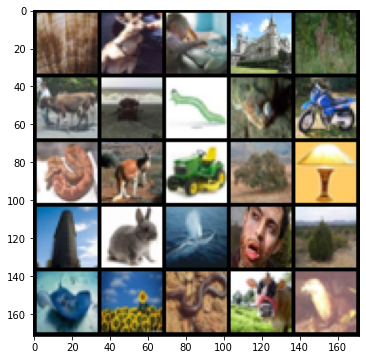

In [5]:
img = next(iter(dataloader))
show(img[0], 25, 5, 6)

## Generator

In [6]:
def generator_block(input, output, kernel_size=3, stride=2, last_layer=False):
  if not last_layer:
    x = nn.Sequential(
        nn.ConvTranspose2d(input, output, kernel_size, stride),
        nn.BatchNorm2d(output),
        nn.ReLU(inplace=True)
    )
  else:
    x = nn.Sequential(
        nn.ConvTranspose2d(input, output, kernel_size, stride),
        nn.Tanh()
    )
  return x

In [7]:
class Generator(nn.Module):
  def __init__(self, noise_dim, image_dim, hidden_dim):
    super(Generator, self).__init__()
    self.noise_dim = noise_dim
    self.generator = nn.Sequential(
        generator_block(noise_dim, hidden_dim * 4, kernel_size=4),
        generator_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
        generator_block(hidden_dim * 2, hidden_dim, kernel_size=4),
        generator_block(hidden_dim, image_dim, kernel_size=2, last_layer=True)
    )
  
  def forward(self, noise):
    noise = noise.view(len(noise), self.noise_dim, 1, 1)
    return self.generator(noise)

## **Discriminator**

In [8]:
def discriminator_block(input, output, kernel_size=4, stride=2, last_layer=False):
  if not last_layer:
    x = nn.Sequential(
        nn.Conv2d(input, output, kernel_size, stride),
        nn.BatchNorm2d(output),
        nn.LeakyReLU(0.2, inplace=True)
    )
  else:
    x = nn.Sequential(
        nn.Conv2d(input, output, kernel_size, stride)
    )
  return x

In [9]:
class Discriminator(nn.Module):
  def __init__(self, image_dim, hidden_dim):
    super(Discriminator, self).__init__()
    self.discriminator = nn.Sequential(
        discriminator_block(image_dim, hidden_dim, stride=1),
        discriminator_block(hidden_dim, hidden_dim * 2),
        discriminator_block(hidden_dim * 2, hidden_dim * 4),
        discriminator_block(hidden_dim * 4, 1, last_layer=True)
    )

  def forward(self, image):
    x = self.discriminator(image)
    return x.view(len(x), -1)

## Classifier

In [10]:
def classifier_block(input, output, kernel_size=3, stride=2, last_layer=False):
  if not last_layer:
    x = nn.Sequential(
        nn.Conv2d(input, output, kernel_size, stride),
        nn.BatchNorm2d(output),
        nn.LeakyReLU(0.2, inplace=True)
    )
  else:
    x = nn.Sequential(
        nn.Conv2d(input, output, kernel_size, stride)
    )

In [11]:
class Classifier(nn.Module):
  def __init__(self, image_dim, classes, hidden_dim):
    super(Classifier, self).__init__()
    self.clf = nn.Sequential(
        classifier_block(image_dim, hidden_dim),
        classifier_block(hidden_dim, hidden_dim * 2),
        classifier_block(hidden_dim * 2, hidden_dim * 4),
        classifier_block(image_dim * 4, classes, last_layer=True)
    )

  def forward(self, image):
    x = self.clf(image)
    return x.view(len(x), -1)

In [12]:
def get_noise_vectors(n_samples, noise_dim, device='cpu'):
  return torch.randn(n_samples, noise_dim, device=device)

In [13]:
def one_hot_encode(n_classes, labels):
  return torch.nn.functional.one_hot(labels, num_classes=n_classes)

In [14]:
def concat_vectors(a, b):
  return torch.cat([a, b], dim=1)

## **Training**

In [15]:
classes = 100
image_shape = (3, 32, 32)
epochs = 100
noise_dim = 64
batch_size = 128
batch_size_clf = 1024
step = 500
lr = 0.0002
device = 'cuda'
generator_input_dim = noise_dim + classes
hidden_dim_gen = 64
hidden_dim_disc = 64
discriminator_input_dim = image_shape[0] + classes

In [16]:
def init_weights(layer):
  if isinstance(layer, nn.ConvTranspose2d) or isinstance(layer, nn.Conv2d):
    torch.nn.init.normal_(layer.weight, 0.0, 0.02)
  if isinstance(layer, nn.BatchNorm2d):
    torch.nn.init.normal_(layer.weight, 0.0, 0.02)
    torch.nn.init.constant_(layer.bias, 0)

In [17]:
generator = Generator(generator_input_dim, image_shape[0], hidden_dim_gen).to(device)
gen_optim = torch.optim.Adam(generator.parameters(), lr=lr)
discr = Discriminator(discriminator_input_dim, hidden_dim_disc).to(device)
disc_optim = torch.optim.Adam(discr.parameters(), lr=lr)

generator = generator.apply(init_weights)
discr = discr.apply(init_weights)

In [18]:
from torch.nn.functional import one_hot
def train_generator():
  cond = ''
  
  criterion = nn.BCEWithLogitsLoss()
  cur_iter = 0
  gen_losses = 0
  discr_losses = 0
  # for epoch in range(epochs):
  ep = 0
  while cond != 'q':
    for image, label in tqdm(dataloader):
      cur_batch_size = len(image)
      image = image.to(device)

      one_hot_labels = one_hot_encode(classes, label.to(device)).float()
      image_cat_onehot_labels = one_hot_labels[:, :, None, None]
      image_cat_onehot_labels = image_cat_onehot_labels.repeat(1, 1, image_shape[1], image_shape[2])

      # Update Discriminator
      disc_optim.zero_grad()
      fake_noise = get_noise_vectors(cur_batch_size, noise_dim, device=device)
      noise_cat_labels = concat_vectors(fake_noise, one_hot_labels)
      fake = generator(noise_cat_labels)

      image_cat_labels_fake = concat_vectors(fake.detach(), image_cat_onehot_labels)
      image_cat_labels_real = concat_vectors(image, image_cat_onehot_labels)
      fake_pred_disc = discr(image_cat_labels_fake)
      real_pred_disc = discr(image_cat_labels_real)

      fake_loss_disc = criterion(fake_pred_disc, torch.zeros_like(fake_pred_disc))
      real_loss_disc = criterion(real_pred_disc, torch.ones_like(real_pred_disc))
      disc_loss = (fake_loss_disc + real_loss_disc)/2
      disc_loss.backward(retain_graph=True)
      disc_optim.step()

      discr_losses += disc_loss.item() / step

      # Update Generator
      gen_optim.zero_grad()
      image_cat_labels_fake = concat_vectors(fake, image_cat_onehot_labels)
      fake_pred_disc = discr(image_cat_labels_fake)
      gen_loss = criterion(fake_pred_disc, torch.ones_like(fake_pred_disc))
      gen_loss.backward()
      gen_optim.step()

      gen_losses += gen_loss.item() / step
      if cur_iter % step == 0 and cur_iter > 0:
        print(f"Step {cur_iter}: Generator loss: {gen_losses}, discriminator loss: {discr_losses}")
        show(fake, 25, 5, 5)
        show(image, 25, 5, 5)
        gen_losses = 0
        discr_losses = 0
      cur_iter += 1
    if ep % 10 == 0:
      cond = input('->')
      torch.save(generator.state_dict(), 'model_weights_gen.pth')
      torch.save(discr.state_dict(), 'model_weights_disc.pth')
    ep += 1

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 500: Generator loss: 2.163859720110892, discriminator loss: 0.2559658703953029


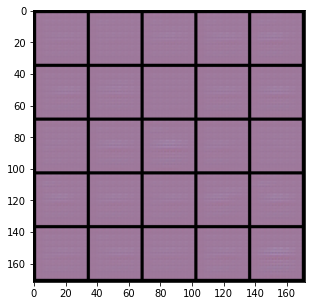

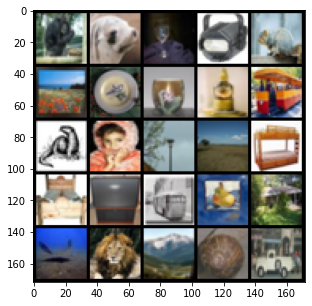

  0%|          | 0/391 [00:00<?, ?it/s]

Step 1000: Generator loss: 4.784997291088101, discriminator loss: 0.014888321689330047


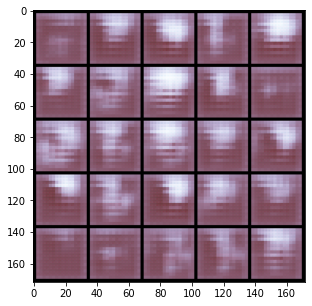

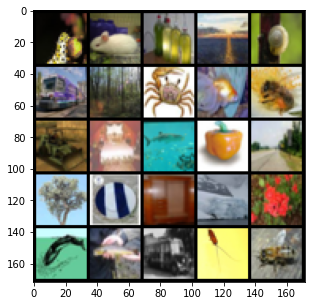

  0%|          | 0/391 [00:00<?, ?it/s]

Step 1500: Generator loss: 4.0310809783935575, discriminator loss: 0.09176547801122069


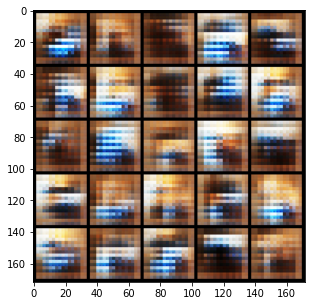

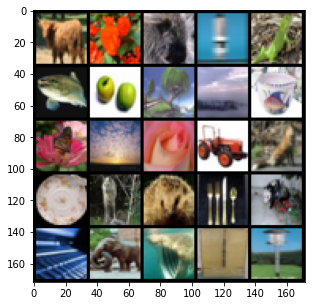

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 2000: Generator loss: 3.1761571016311634, discriminator loss: 0.17421920774132005


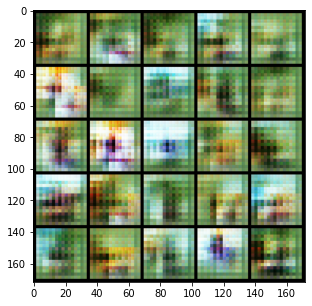

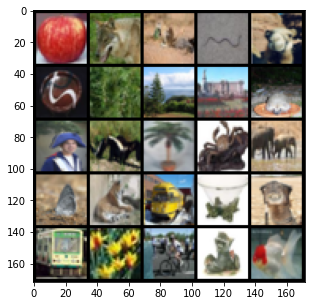

  0%|          | 0/391 [00:00<?, ?it/s]

Step 2500: Generator loss: 3.0879828586578353, discriminator loss: 0.2033033574223518


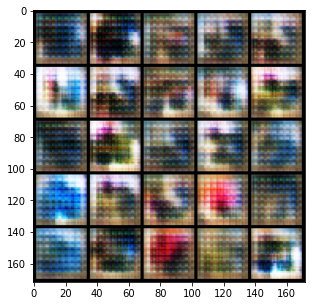

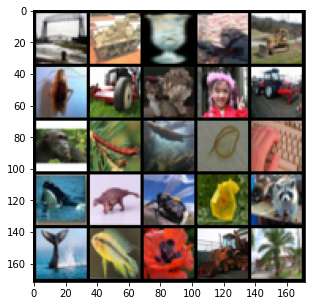

  0%|          | 0/391 [00:00<?, ?it/s]

Step 3000: Generator loss: 3.0747240886688245, discriminator loss: 0.19897451023757456


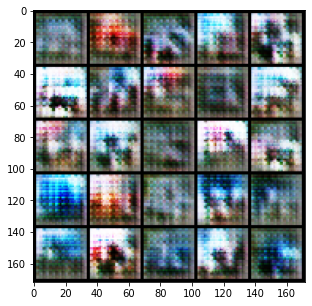

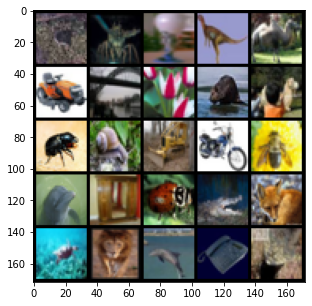

  0%|          | 0/391 [00:00<?, ?it/s]

Step 3500: Generator loss: 3.057345902442932, discriminator loss: 0.2046715157032013


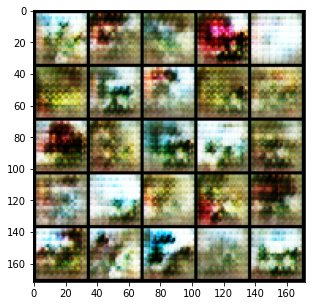

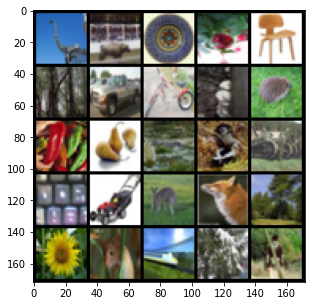

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 4000: Generator loss: 2.634771138429642, discriminator loss: 0.26345540313422666


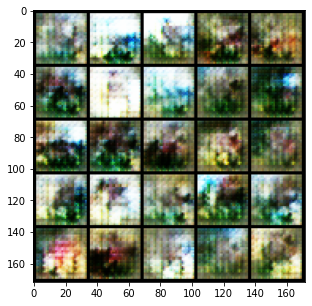

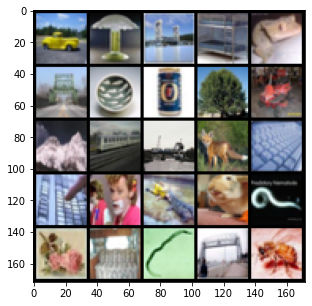

  0%|          | 0/391 [00:00<?, ?it/s]

Step 4500: Generator loss: 2.5862091158628466, discriminator loss: 0.2691190097928045


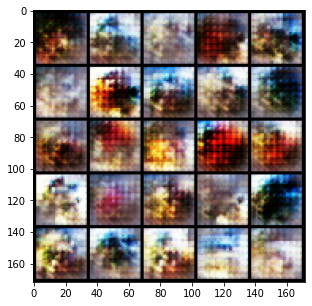

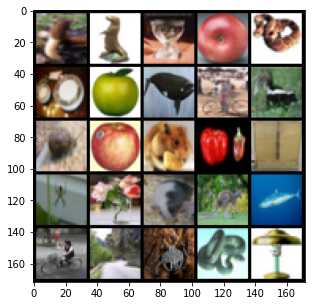

  0%|          | 0/391 [00:00<?, ?it/s]

Step 5000: Generator loss: 2.4367846714258206, discriminator loss: 0.31323989179730416


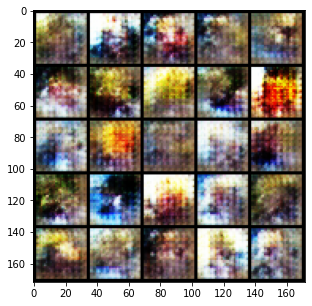

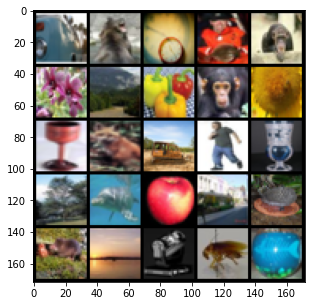

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 5500: Generator loss: 2.4354961919784537, discriminator loss: 0.34161402508616395


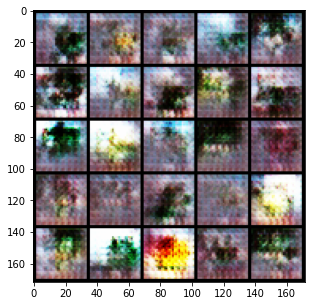

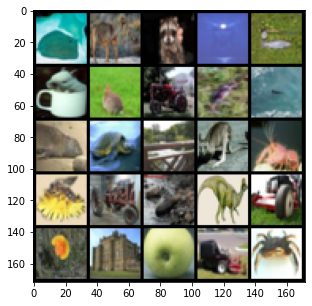

  0%|          | 0/391 [00:00<?, ?it/s]

Step 6000: Generator loss: 2.2542568644285192, discriminator loss: 0.33651659533381434


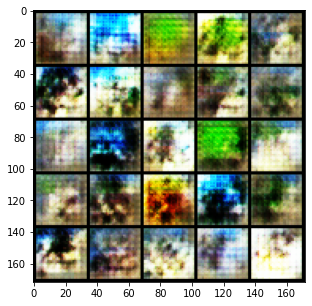

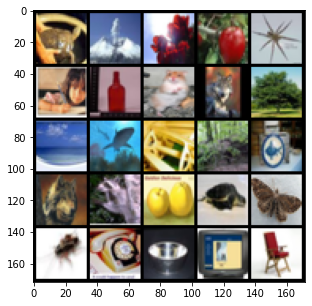

  0%|          | 0/391 [00:00<?, ?it/s]

Step 6500: Generator loss: 2.1817508788108824, discriminator loss: 0.3661867657303806


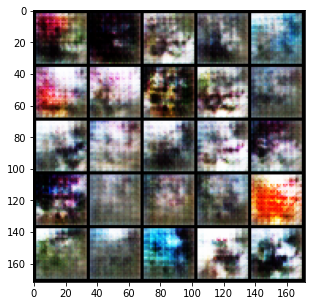

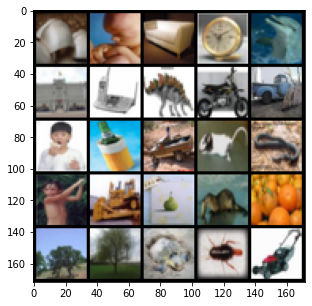

  0%|          | 0/391 [00:00<?, ?it/s]

Step 7000: Generator loss: 2.1167385611534115, discriminator loss: 0.3641769782900813


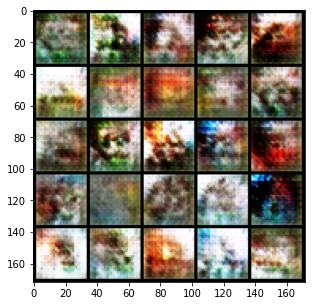

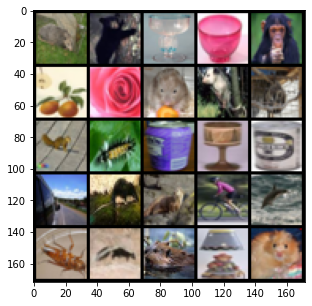

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 7500: Generator loss: 2.1660734231472016, discriminator loss: 0.3516665104031561


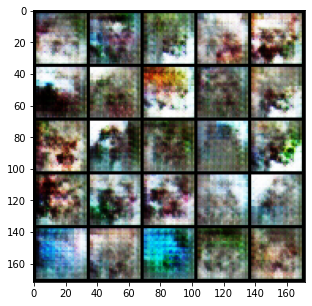

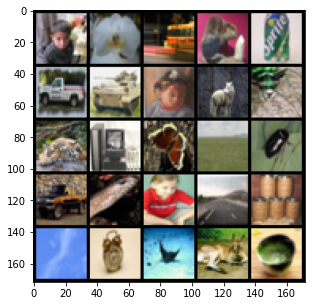

  0%|          | 0/391 [00:00<?, ?it/s]

Step 8000: Generator loss: 2.014061161994935, discriminator loss: 0.3902817305922508


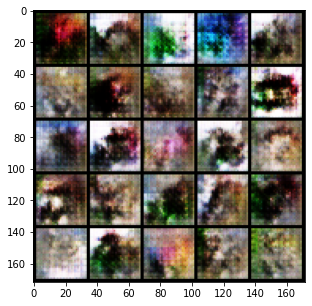

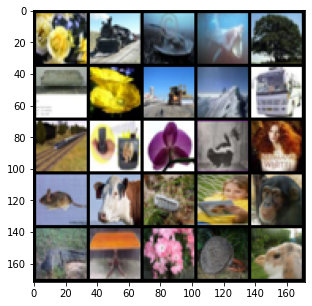

  0%|          | 0/391 [00:00<?, ?it/s]

Step 8500: Generator loss: 2.105687460601331, discriminator loss: 0.36364494684338566


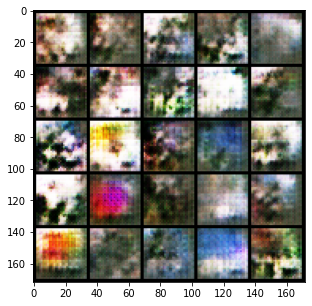

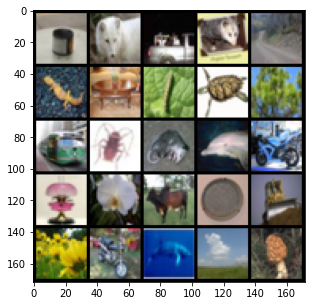

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 9000: Generator loss: 1.9859637176990512, discriminator loss: 0.3562680337429046


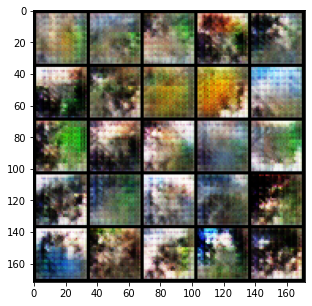

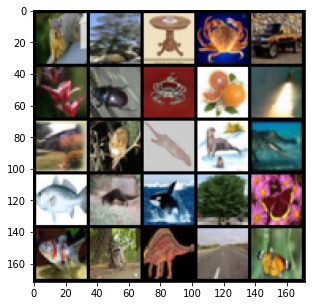

  0%|          | 0/391 [00:00<?, ?it/s]

Step 9500: Generator loss: 2.008564730525017, discriminator loss: 0.396975534796715


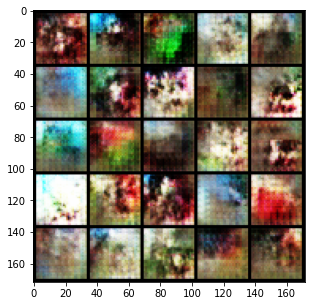

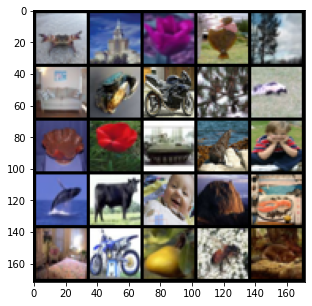

  0%|          | 0/391 [00:00<?, ?it/s]

Step 10000: Generator loss: 1.941322539806366, discriminator loss: 0.3967998316287993


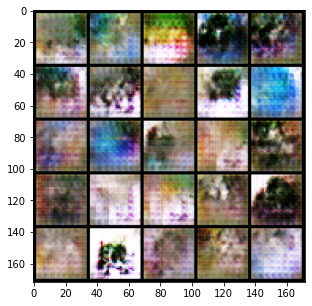

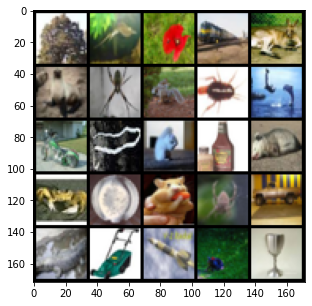

  0%|          | 0/391 [00:00<?, ?it/s]

Step 10500: Generator loss: 1.8559941313266763, discriminator loss: 0.40798827368021046


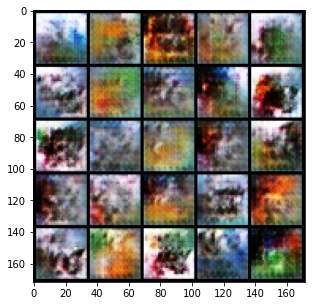

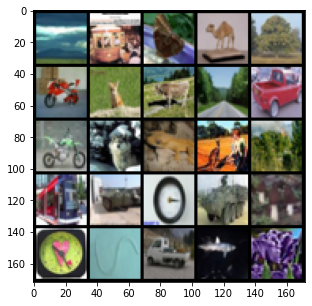

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 11000: Generator loss: 1.930625723123552, discriminator loss: 0.3979554347097878


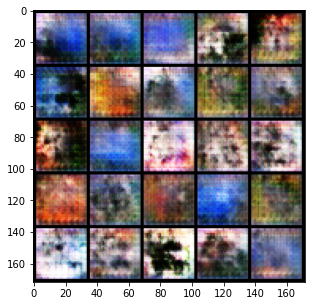

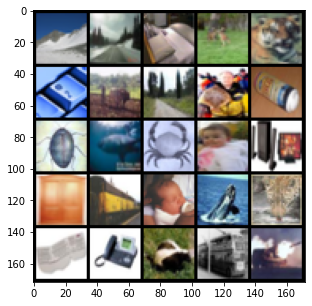

  0%|          | 0/391 [00:00<?, ?it/s]

Step 11500: Generator loss: 1.8300802809000003, discriminator loss: 0.4112532127201558


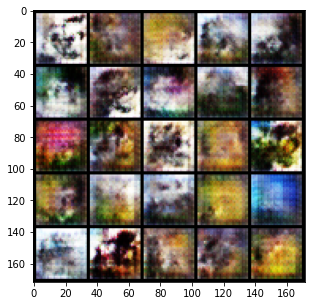

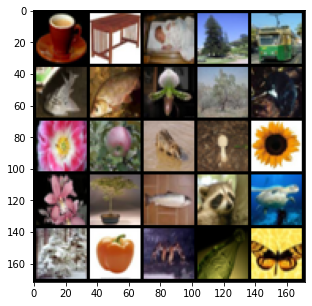

  0%|          | 0/391 [00:00<?, ?it/s]

Step 12000: Generator loss: 1.8219736135005957, discriminator loss: 0.4292036998569963


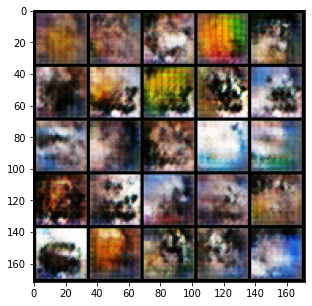

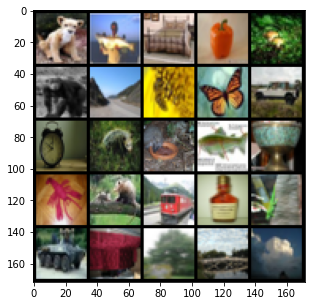

  0%|          | 0/391 [00:00<?, ?it/s]

Step 12500: Generator loss: 1.8464008171558361, discriminator loss: 0.3940625604391095


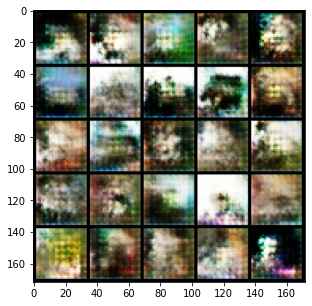

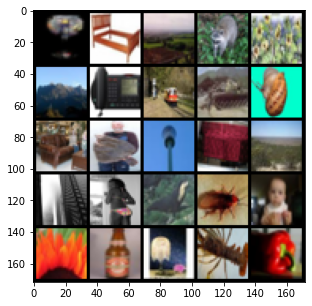

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 13000: Generator loss: 1.852557545065882, discriminator loss: 0.40791789200901957


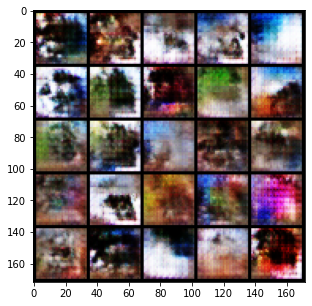

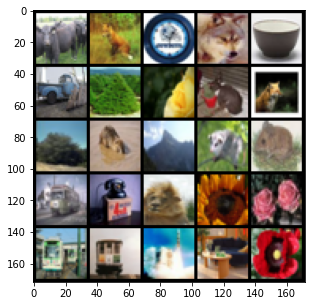

  0%|          | 0/391 [00:00<?, ?it/s]

Step 13500: Generator loss: 1.836362153053284, discriminator loss: 0.3663917526304724


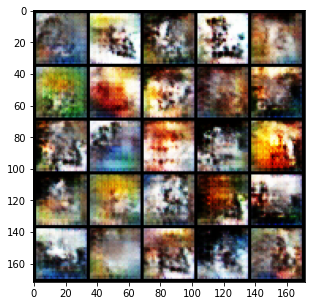

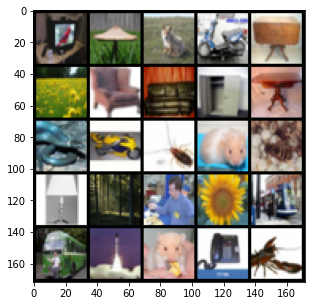

  0%|          | 0/391 [00:00<?, ?it/s]

Step 14000: Generator loss: 1.972848253488542, discriminator loss: 0.350998697608709


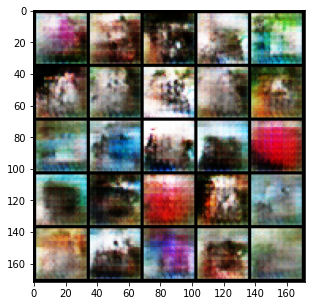

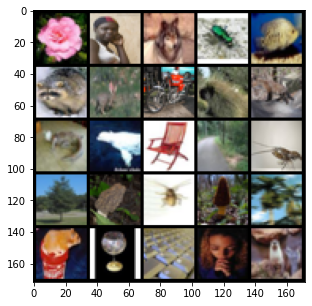

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 14500: Generator loss: 2.111171301841735, discriminator loss: 0.3237142878174785


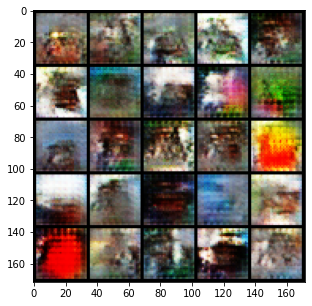

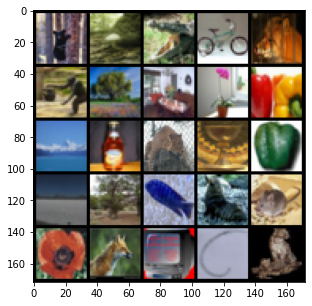

  0%|          | 0/391 [00:00<?, ?it/s]

Step 15000: Generator loss: 2.0494894920587527, discriminator loss: 0.35748030224442523


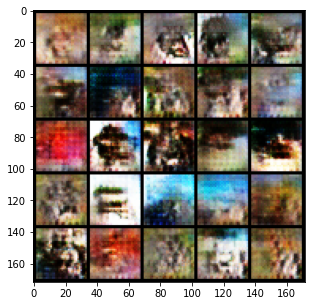

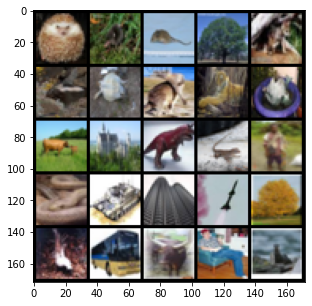

  0%|          | 0/391 [00:00<?, ?it/s]

Step 15500: Generator loss: 1.8526196057796491, discriminator loss: 0.4044837177395818


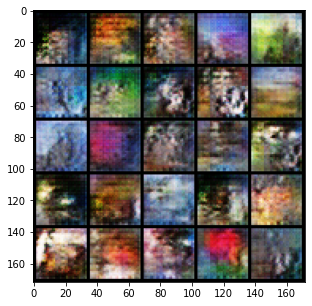

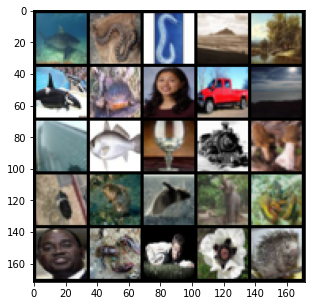

  0%|          | 0/391 [00:00<?, ?it/s]

Step 16000: Generator loss: 1.8141132126450543, discriminator loss: 0.40392676034569774


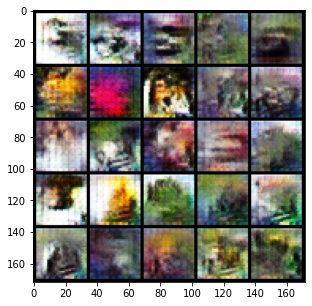

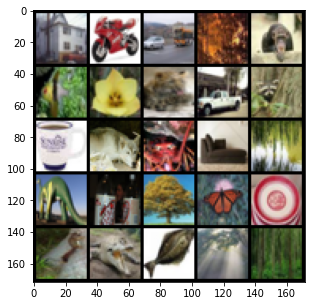

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 16500: Generator loss: 1.854271509885788, discriminator loss: 0.4073156901896


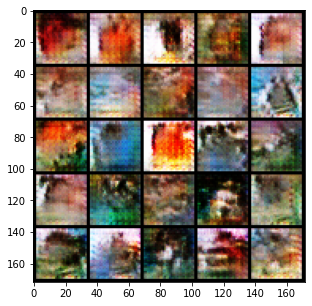

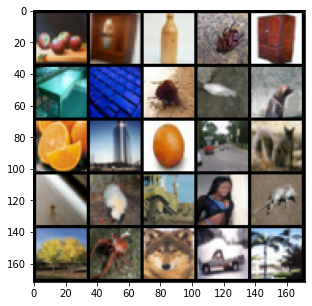

  0%|          | 0/391 [00:00<?, ?it/s]

Step 17000: Generator loss: 1.8637832916378974, discriminator loss: 0.40547748976945863


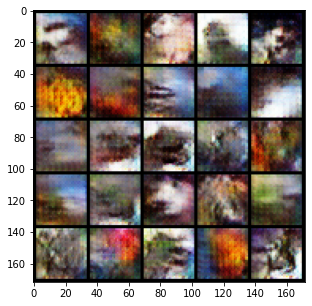

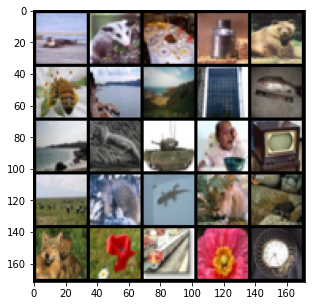

  0%|          | 0/391 [00:00<?, ?it/s]

Step 17500: Generator loss: 1.7020214989781404, discriminator loss: 0.43603740847110745


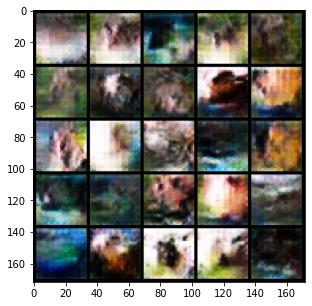

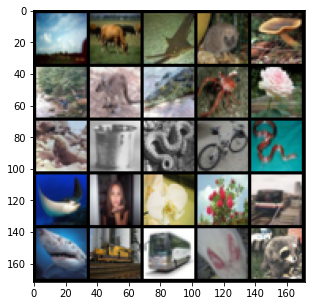

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 18000: Generator loss: 1.794632951259614, discriminator loss: 0.41553064393997163


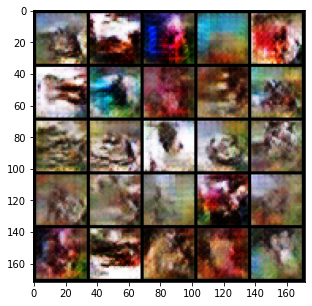

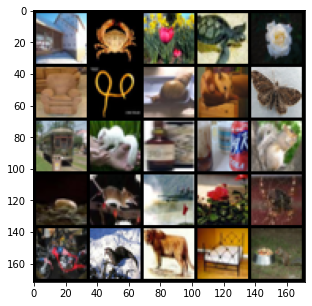

  0%|          | 0/391 [00:00<?, ?it/s]

Step 18500: Generator loss: 1.7961077337265035, discriminator loss: 0.4175732377469539


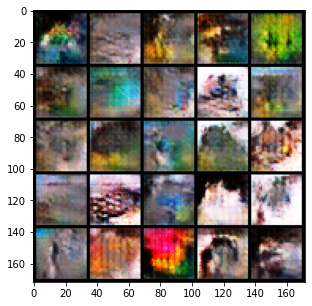

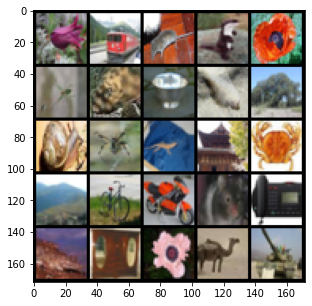

  0%|          | 0/391 [00:00<?, ?it/s]

Step 19000: Generator loss: 1.8310838001966476, discriminator loss: 0.4247964065670962


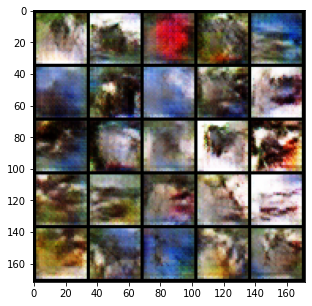

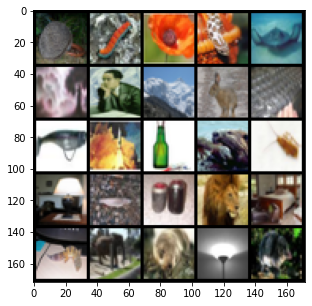

  0%|          | 0/391 [00:00<?, ?it/s]

Step 19500: Generator loss: 1.8418346099853535, discriminator loss: 0.39712516713142376


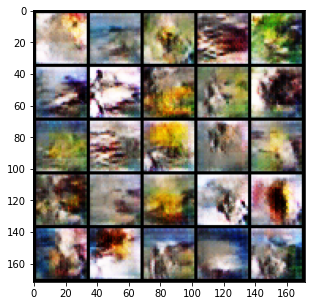

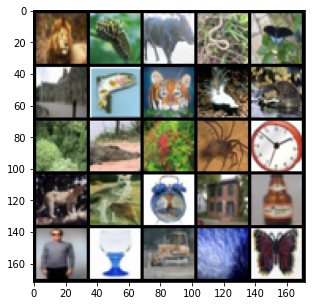

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 20000: Generator loss: 1.8703283554315573, discriminator loss: 0.39266841736435915


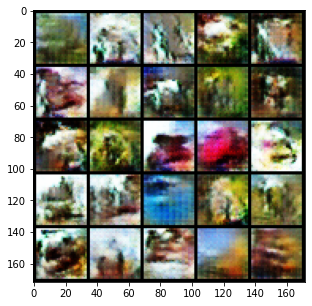

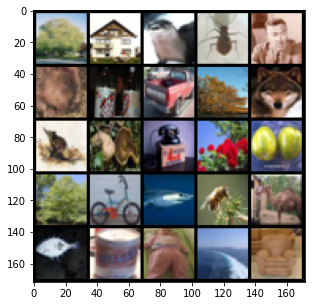

  0%|          | 0/391 [00:00<?, ?it/s]

Step 20500: Generator loss: 1.7872063598632821, discriminator loss: 0.3989525920450686


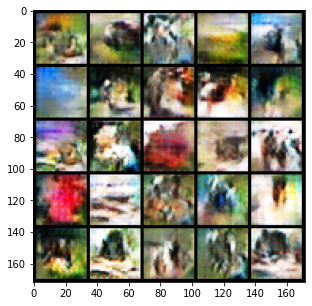

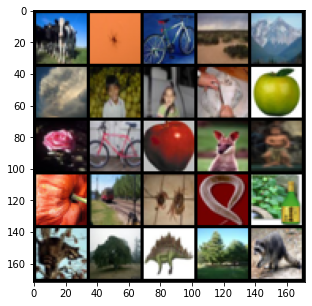

  0%|          | 0/391 [00:00<?, ?it/s]

Step 21000: Generator loss: 1.828479537010192, discriminator loss: 0.4082652810811994


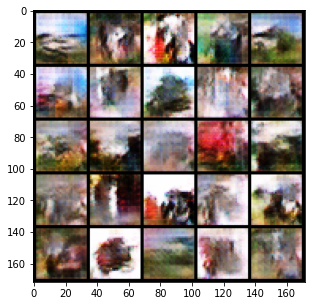

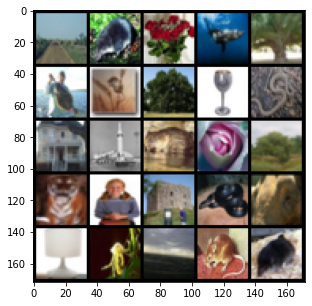

  0%|          | 0/391 [00:00<?, ?it/s]

Step 21500: Generator loss: 1.7987220749855055, discriminator loss: 0.4057597393393518


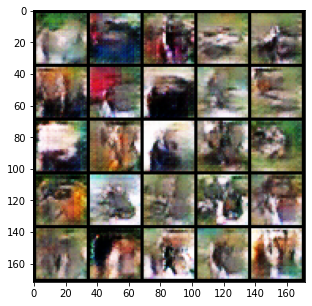

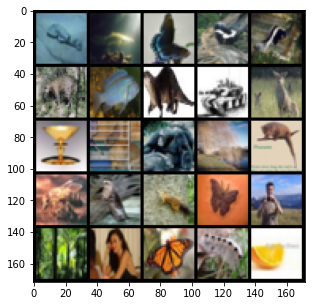

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 22000: Generator loss: 1.8295377237796773, discriminator loss: 0.40145008638501184


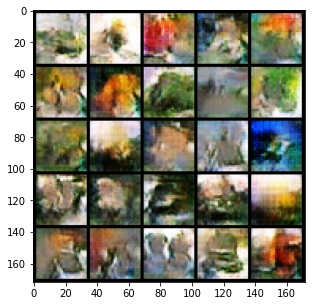

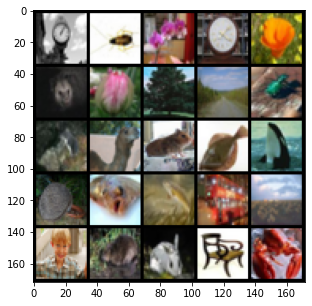

  0%|          | 0/391 [00:00<?, ?it/s]

Step 22500: Generator loss: 1.7538090307116505, discriminator loss: 0.4055982169210914


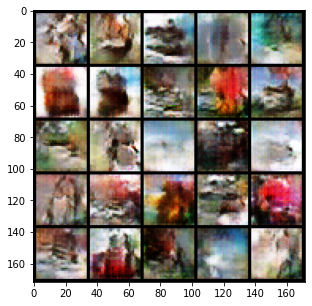

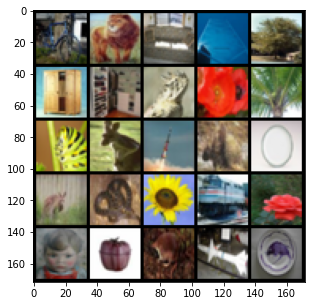

  0%|          | 0/391 [00:00<?, ?it/s]

Step 23000: Generator loss: 1.7531018638610838, discriminator loss: 0.4140896409749985


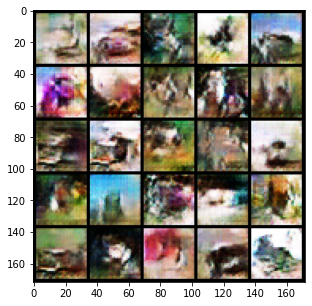

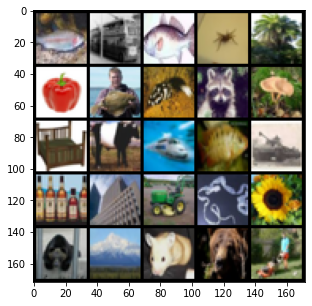

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 23500: Generator loss: 1.8029786506891243, discriminator loss: 0.39628741434216486


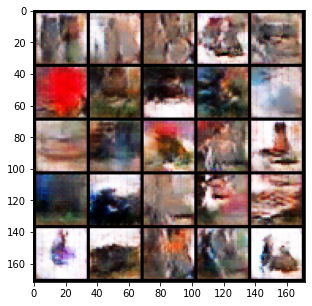

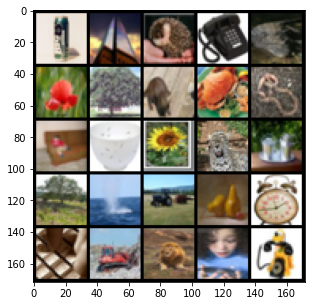

  0%|          | 0/391 [00:00<?, ?it/s]

Step 24000: Generator loss: 1.8478390737771981, discriminator loss: 0.4295171082019808


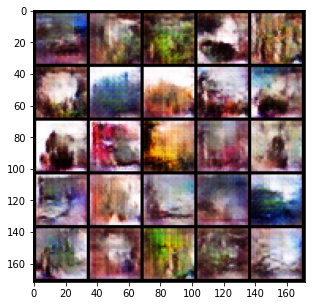

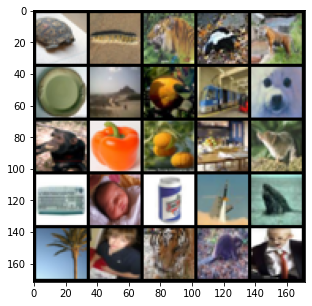

  0%|          | 0/391 [00:00<?, ?it/s]

Step 24500: Generator loss: 1.6976560238599796, discriminator loss: 0.4122298798263072


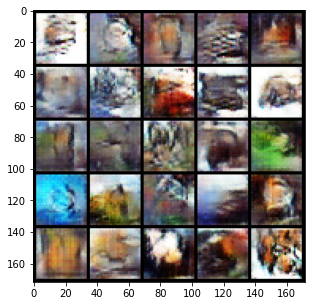

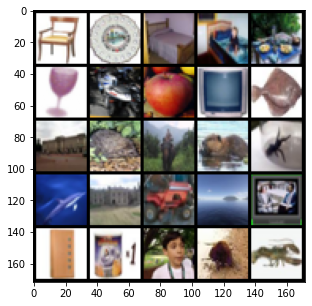

  0%|          | 0/391 [00:00<?, ?it/s]

Step 25000: Generator loss: 1.6849453965425474, discriminator loss: 0.4257540488839148


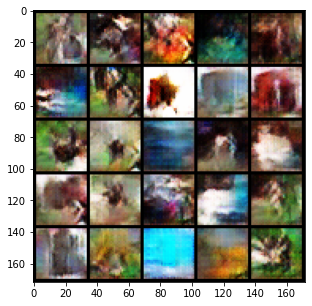

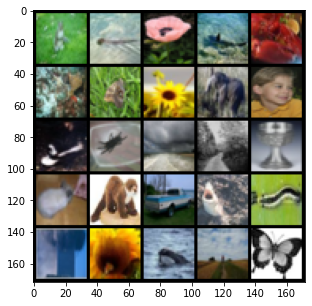

  0%|          | 0/391 [00:00<?, ?it/s]

  0%|          | 0/391 [00:00<?, ?it/s]

Step 25500: Generator loss: 1.70844549369812, discriminator loss: 0.42213552650809283


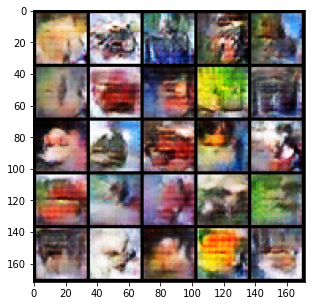

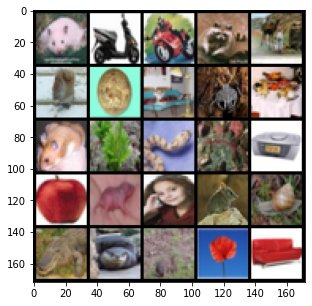

  0%|          | 0/391 [00:00<?, ?it/s]

Step 26000: Generator loss: 1.8287561423778547, discriminator loss: 0.3859186909794809


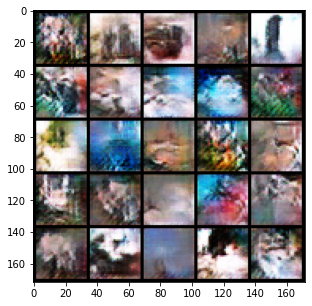

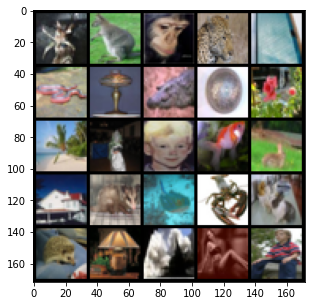

  0%|          | 0/391 [00:00<?, ?it/s]

->q
Step 26500: Generator loss: 1.7497476472854598, discriminator loss: 0.39558832255005844


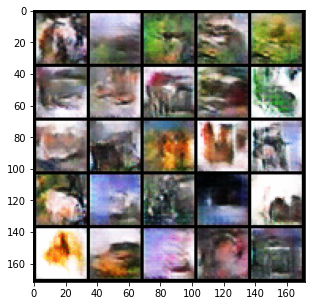

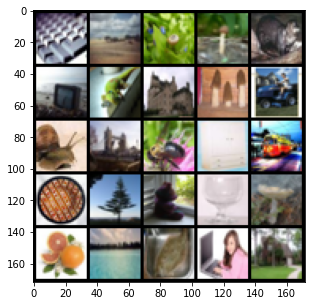

  0%|          | 0/391 [00:00<?, ?it/s]

In [ ]:
# train_generator()

In [21]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [22]:
gen_weights = 'drive/MyDrive/model_weights_gen.pth'

In [23]:
generator.load_state_dict(torch.load(gen_weights))
generator.eval()

Generator(
  (generator): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(164, 256, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(64, 3, kernel_size=(2, 2), stride=(2, 2))
      (1): Tanh()
    )
  )
)

## Generating some fakes

torch.Size([128])


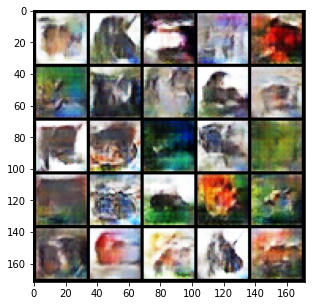

In [29]:
image, label = next(iter(dataloader))
print(label.size())
one_hot_labels = one_hot_encode(100, label.to(device)).float()
fake_noise = get_noise_vectors(128, noise_dim, device=device)
noise_cat_labels = concat_vectors(fake_noise, one_hot_labels)
fake = generator(noise_cat_labels)
show(fake, 25, 5, 5)

In [30]:
def train_classifier():
  classifier = Classifier(image_shape[0], classes, 32).to(device)
  clf_optim = torch.optim.Adam(classifier.parameters(), lr=lr)
  criterion = nn.BCEWithLogitsLoss()
  cur_iter = 0
  for epoch in range(epochs):
    for image, label in tqdm(dataloader):
      cur_batch_size = len(image)
      image = image.to(device)
      label = label.to(device)

      clf_optim.zero_grad()
      pred_label = classifier(image.detach())
      clf_loss = criterion(pred_label, label)
      clf_loss.backward()
      clf_optim.step()

      if cur_iter % step == 0:
          classifier_val_loss = 0
          classifier_correct = 0
          num_validation = 0
          for val_example, val_label in val_loader:
              cur_batch_size = len(val_example)
              num_validation += cur_batch_size
              val_example = val_example.to(device)
              val_label = val_label.to(device)
              labels_hat = classifier(val_example)
              classifier_val_loss += criterion(labels_hat, val_label) * cur_batch_size
              classifier_correct += (labels_hat.argmax(1) == val_label).float().sum()

          print(f"Step {cur_iter}: "
                  f"Classifier loss: {classifier_val_loss.item() / num_validation}, "
                  f"classifier accuracy: {classifier_correct.item() / num_validation}")
      cur_iter += 1

In [31]:
train_classifier()

ValueError: ignored